# ДЗ по уроку 4

## Условие 1: Задача 1

Постройте график <br>
Назовите график<br>
Сделайте именование оси x и оси y<br>
Сделайте выводы

### 1.1 Скачать данные

Скачать данные по ссылке https://www.kaggle.com/datasets/esratmaria/house-price-dataset-with-other-information

### 1.2 Изучите стоимости недвижимости

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('kc_house_data.csv')

In [3]:
df['year_mon'] = df['date'].apply(lambda x: '.'.join([x[:4],x[4:6]]))

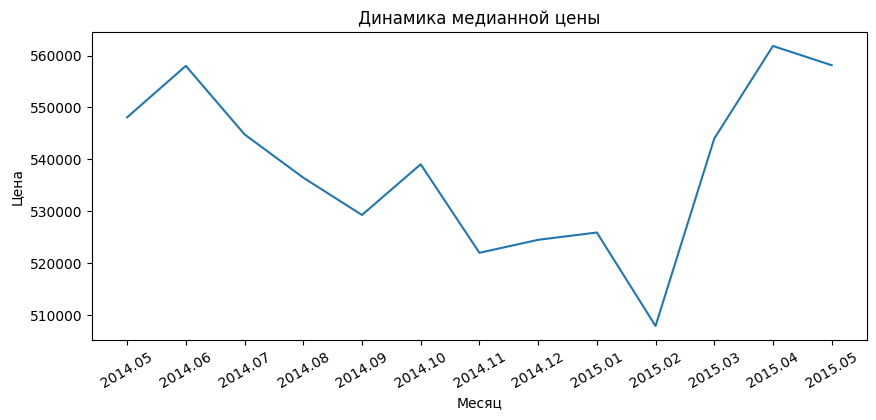

In [4]:
df_graph = df.groupby('year_mon')['price'].agg(np.mean).reset_index().sort_values(by='year_mon')
plt.figure(figsize=(10, 4))
sns.lineplot(x=df_graph['year_mon'], y=df_graph['price'])
plt.title('Динамика медианной цены')
plt.xlabel('Месяц')
plt.ylabel('Цена')
plt.xticks(rotation = 30);

Сложно сделать какой-то вывод на таком ограниченном объеме данных. Вероятно, имеет место сезонность (провал в феврале, пик - в апреле).

### 1.3 Изучите распределение квадратуры жилой

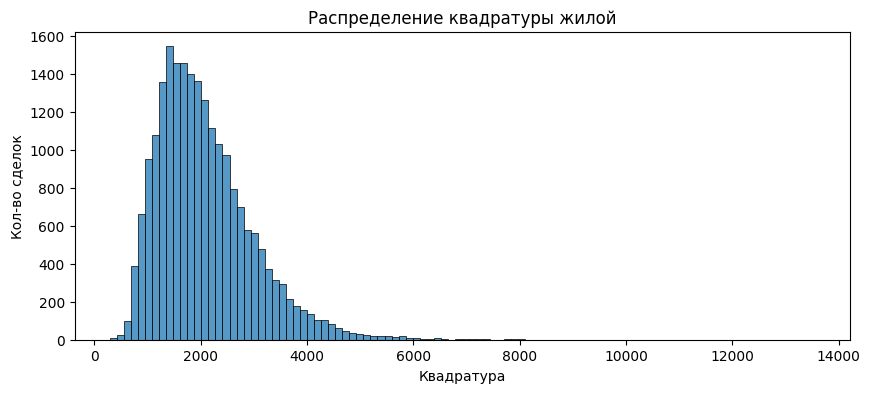

In [5]:
plt.figure(figsize=(10, 4))
sns.histplot(df['sqft_living'], bins=100)
plt.title('Распределение квадратуры жилой')
plt.xlabel('Квадратура')
plt.ylabel('Кол-во сделок');

Распределение похоже на нормальное с ярко выраженным пиком 2000 кв.футов, но со смещением в сторону больших площадей. 

### 2.1.4 Изучите распределение года постройки

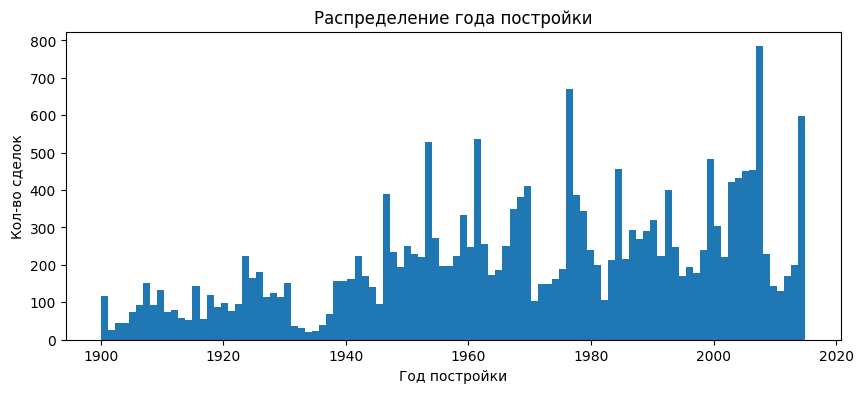

In [6]:
plt.figure(figsize=(10, 4))
plt.hist(df['yr_built'], bins=100)
plt.title('Распределение года постройки')
plt.xlabel('Год постройки')
plt.ylabel('Кол-во сделок');

Логика в распределении не прослеживается. Вероятно, зависимость от внешних факторов (во времена великой депрессии и другие периоды кризисов почти не строили). 

## Условие 2: 2 задача

### 2.1 Изучите распределение домов от наличия вида на набережную

In [7]:
df_graph = df['waterfront'].value_counts()
df_graph.index = ['Нет', 'Да']

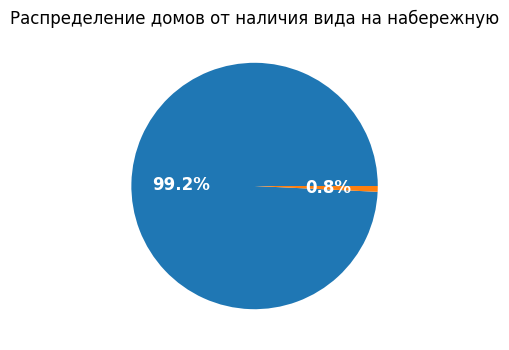

In [8]:
plt.figure(figsize=(10, 4))
plt.pie(df_graph, labels=['Нет', 'Да'], autopct='%1.1f%%', # explode=(0, 0.5), 
        textprops=dict(color="w", size=12, weight="bold"))
plt.title('Распределение домов от наличия вида на набережную');

Доля домов с видом на набережную менее 1%

### 2.2 Изучите распределение этажей домов

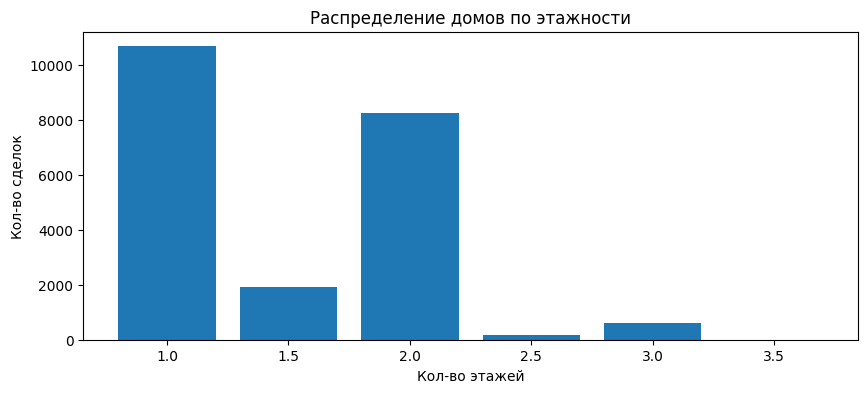

In [9]:
df_graph = df['floors'].value_counts().reset_index().sort_values(by='index')
df_graph['index'] = df_graph['index'].apply(lambda x: str(x))
plt.figure(figsize=(10, 4))
# sns.barplot(x=df_graph['index'], y=df_graph['floors'])
plt.bar(df_graph['index'], df_graph['floors'])
plt.title('Распределение домов по этажности');
plt.xlabel('Кол-во этажей')
plt.ylabel('Кол-во сделок');

Этажность домов низкая, преобладают одноэтажные дома.

### 2.2 Изучите распределение состояния домов

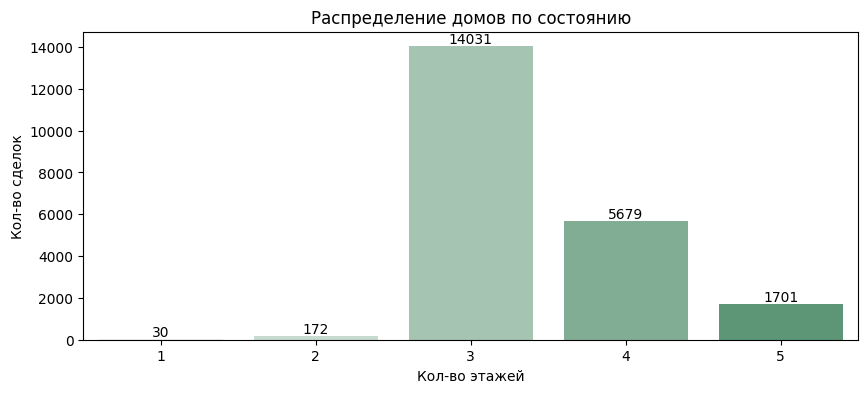

In [10]:
df_graph = df['condition'].value_counts().reset_index().sort_values(by='index')
df_graph['index'] = df_graph['index'].apply(lambda x: str(x))
plt.figure(figsize=(10, 4))
color_palette = sns.light_palette("seagreen")
splot = sns.barplot(x=df_graph['index'], y=df_graph['condition'], palette = color_palette)
for g in splot.patches:
    splot.annotate(format(g.get_height(), '.0f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 5),
                   textcoords = 'offset points')
plt.title('Распределение домов по состоянию');
plt.xlabel('Кол-во этажей')
plt.ylabel('Кол-во сделок');

## Условие 3: 3 задача

Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока. <br>
Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.

Попробуем решить задачу "в лоб".

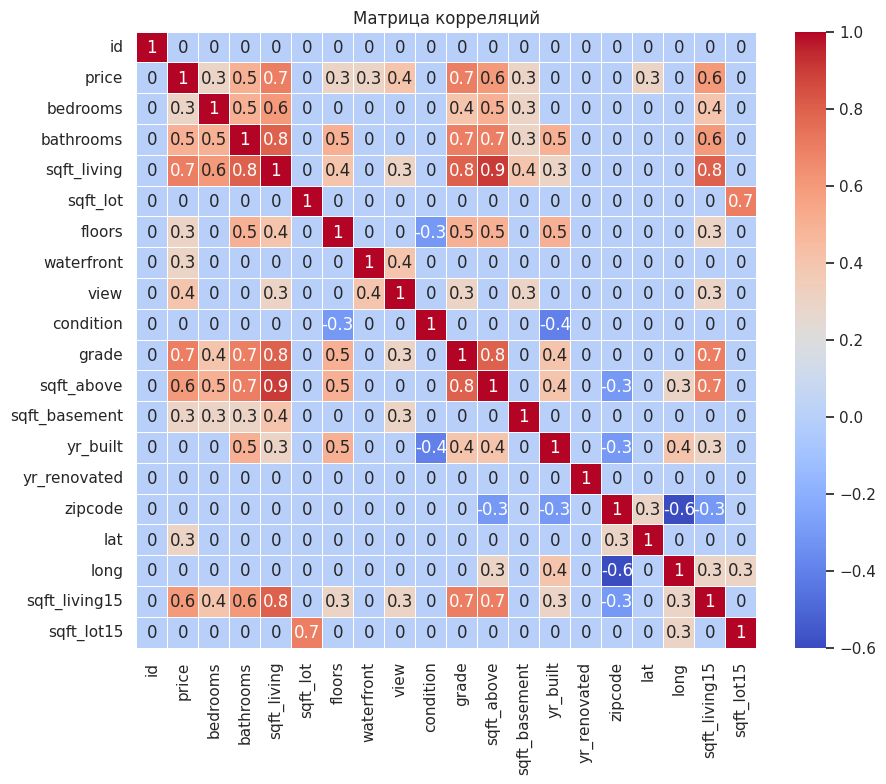

In [11]:
corr_matrix = df.corr(numeric_only=True)
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
plt.figure(figsize=(10, 8))

sns.set(font_scale=1)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Матрица корреляций');

In [12]:
price_corr = corr_matrix['price'].reset_index().sort_values(by='price', ascending=False)
price_corr[price_corr['price']>0.3]

,index,price
1,price,1.0
10,grade,0.7
4,sqft_living,0.7
18,sqft_living15,0.6
11,sqft_above,0.6
3,bathrooms,0.5
8,view,0.4


Видим достаточно сильную корреляцию с рядом характеристик. <br>
Начнем анализ с наиболее простых и однозначных. 

Рассмотрим влияние вида на воду.

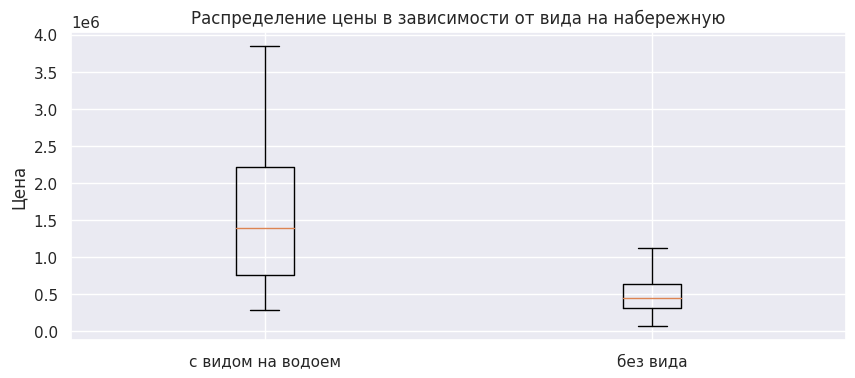

In [28]:
data1 = df['price'][df['waterfront'] == 1]
data2 = df['price'][df['waterfront'] == 0]

plt.figure(figsize=(10, 4))

plt.boxplot([data1, data2], showfliers=False)

plt.title('Распределение цены в зависимости от вида на набережную')
plt.ylabel('Цена')
plt.xticks([1, 2], ['с видом на водоем', 'без вида']);

<b><i> Наличие вида на водоем определенно является фактором, влияющим на цену. </i></b> <br>
Зависимость не линейная и набор значений мал, поэтому на матрице корреляций мы его не заметили. <br>

Наиболее высокая корреляция была с общей оценкой дома. Рассмотрим эту зависимость более подробно.

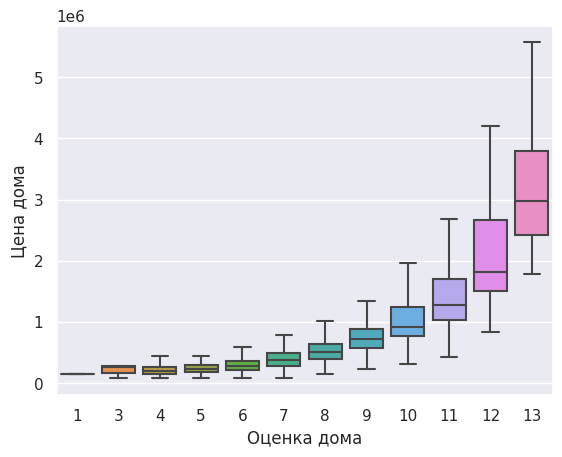

In [14]:
sns.boxplot(x=df['grade'], y=df['price'], showfliers=False)
plt.xlabel('Оценка дома')
plt.ylabel('Цена дома');

<b><i>Оценка дома безусловно влияет на его стоимость.</i></b><br>
Однако зависимость не линейная. Вероятно, премиум сегмент имеет более высокую торговую наценку. Также можно предположить наличие других влияющих параметров.

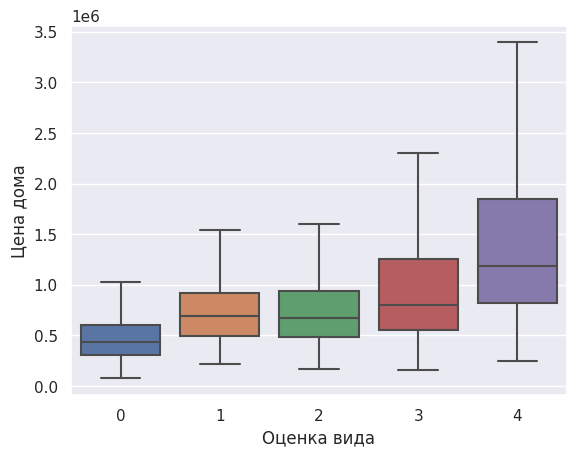

In [15]:
sns.boxplot(x=df['view'], y=df['price'], showfliers=False)
plt.xlabel('Оценка вида')
plt.ylabel('Цена дома');

<b><i>Зависимость от оценки дома присутствует</b></i> <br>
Но также не вполне является линейной, хотя профиль распределения напоминает предыдущий.

Рассмотрим относительно дискретные факторы - количество этажей, спален, ванных комнат.

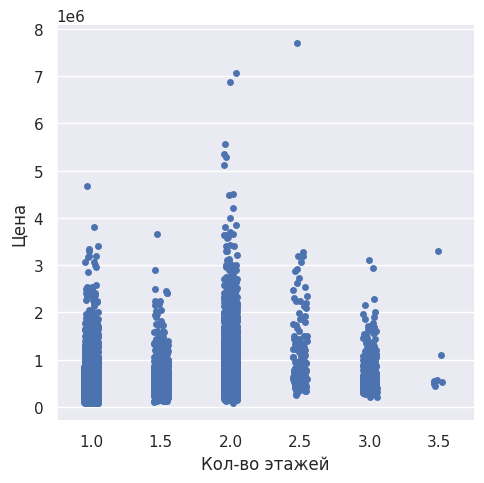

In [16]:
ss = sns.catplot(data=df, x="floors", y="price",)
plt.xlabel('Кол-во этажей')
plt.ylabel('Цена');

Как видим, этажность не сильно влияет на цену (распределение похоже на нормальное)

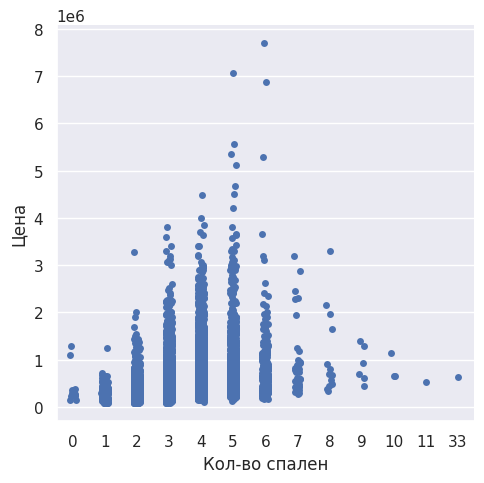

In [17]:
ss = sns.catplot(data=df, x="bedrooms", y="price")
plt.xlabel('Кол-во спален')
plt.ylabel('Цена');

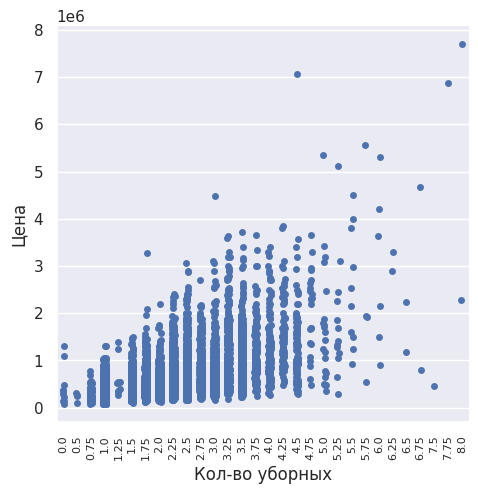

In [18]:
ss = sns.catplot(data=df, x="bathrooms", y="price")
plt.xlabel('Кол-во уборных')
plt.ylabel('Цена')
plt.xticks(fontsize=8, rotation=90);

Количество спален незначительно влияет на цену в области 5+ (в целом распределение похоже на нормальное). <br>
Количество уборных, напротив, сильно коррелирует с ценой (это соответствует определенному ранее коэффициенту корреляции).

Рассмотрим жилую площадь.

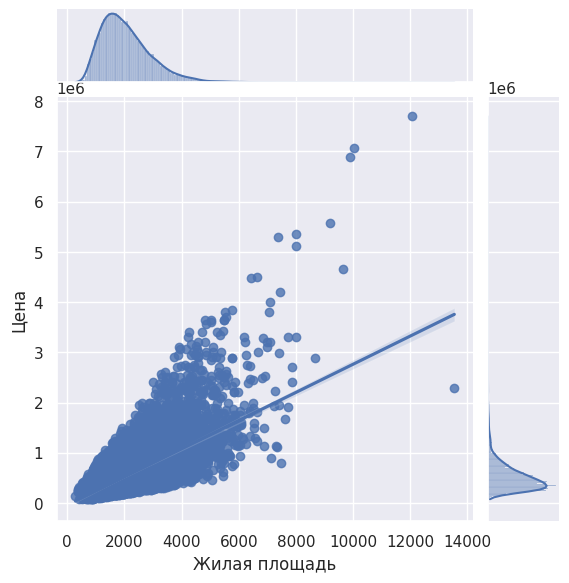

In [19]:
ss = sns.jointplot(x=df['sqft_living'], y=df['price'], kind='reg')
plt.xlabel('Жилая площадь')
plt.ylabel('Цена');

Видим связь двух показателей, но достаточно большой разброс стоимости квадратного метра. Попробуем перейти к анализу зависимости именно этого показателя.

In [20]:
df['ppf']=df['price']/df['sqft_living']

Рассмотрим корреляцию данного показателя

,index,ppf
20,ppf,1.0
1,price,0.6
16,lat,0.5


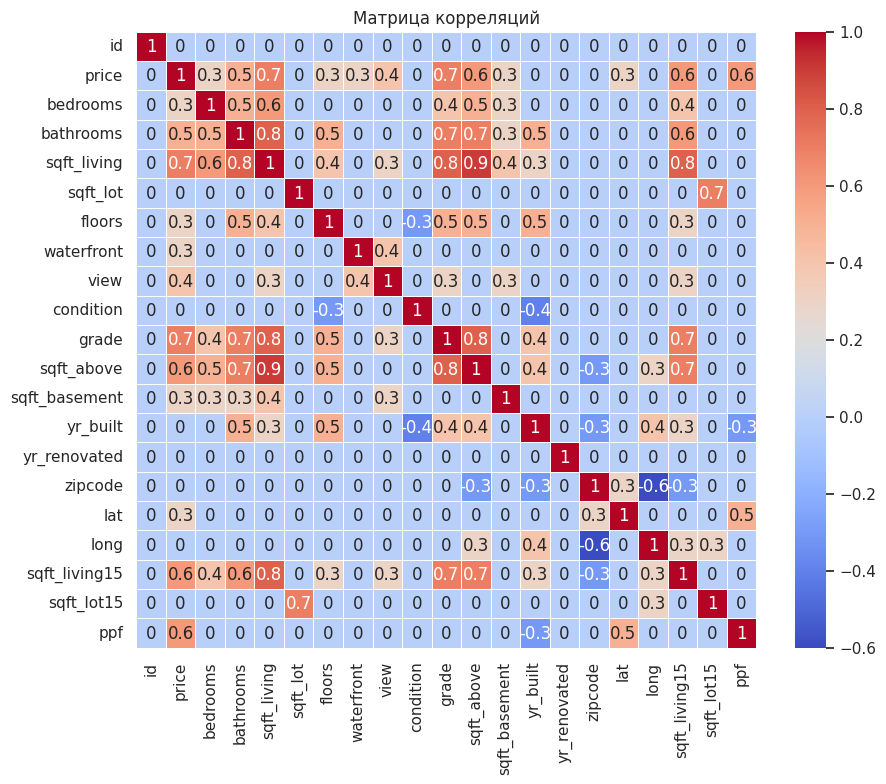

In [21]:
corr_matrix = df.corr(numeric_only=True)
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
price_corr = corr_matrix['ppf'].reset_index().sort_values(by='ppf', ascending=False)
plt.figure(figsize=(10, 8))

sns.set(font_scale=1)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Матрица корреляций');

price_corr[price_corr['ppf']>0.3]

Очень странно, что корреляций практически не обнаружено (отметим слабую братную корреляцию с годом постойки здания).

Попробуем построить зависимость цены метра от оценки дома и вида.

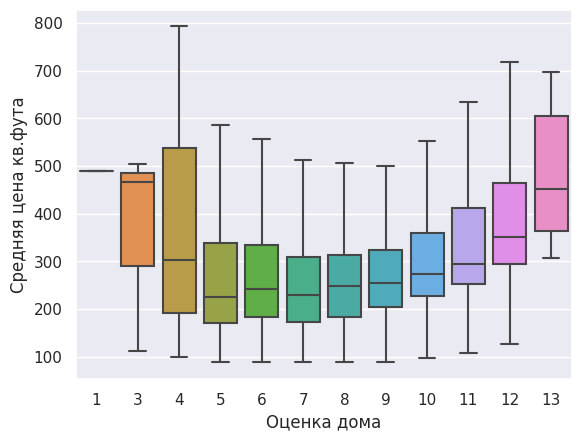

In [22]:
sns.boxplot(x=df['grade'], y=df['ppf'], showfliers=False)
plt.xlabel('Оценка дома')
plt.ylabel('Средняя цена кв.фута');

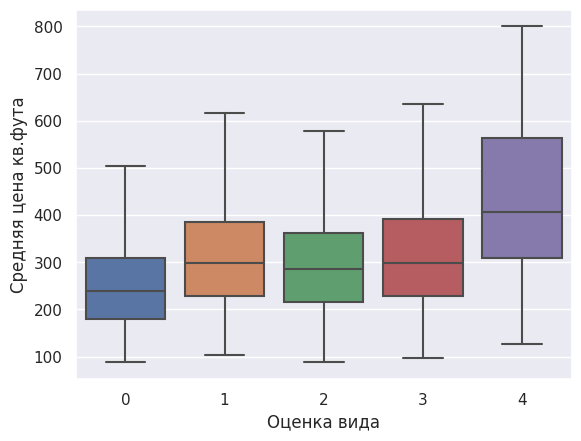

In [23]:
sns.boxplot(x=df['view'], y=df['ppf'], showfliers=False)
plt.xlabel('Оценка вида')
plt.ylabel('Средняя цена кв.фута');

Рассмотрим медианное значение цены квадратного фута вместо распределения.

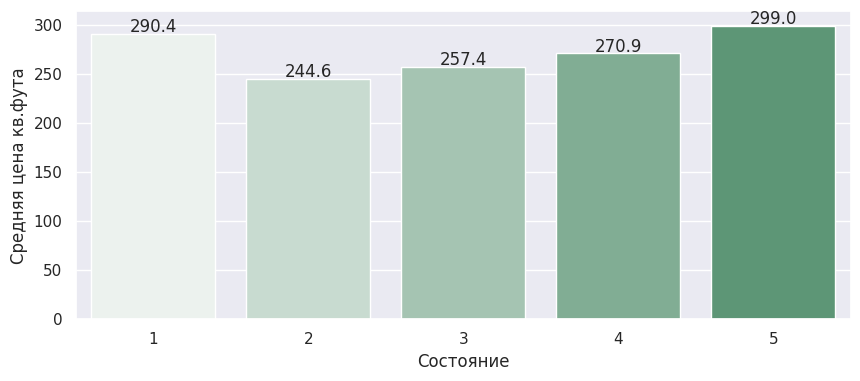

In [24]:
# sns.boxplot(x=df['view'], y=df['ppf'])
df_graph = df.groupby('condition')['ppf'].agg(np.mean).reset_index()

plt.figure(figsize=(10, 4))
color_palette = sns.light_palette("seagreen")
splot = sns.barplot(x=df_graph['condition'], y=df_graph['ppf'], palette = color_palette)
for g in splot.patches:
    splot.annotate(format(g.get_height(), '.1f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 5),
                   textcoords = 'offset points')
plt.xlabel('Состояние')
plt.ylabel('Средняя цена кв.фута');

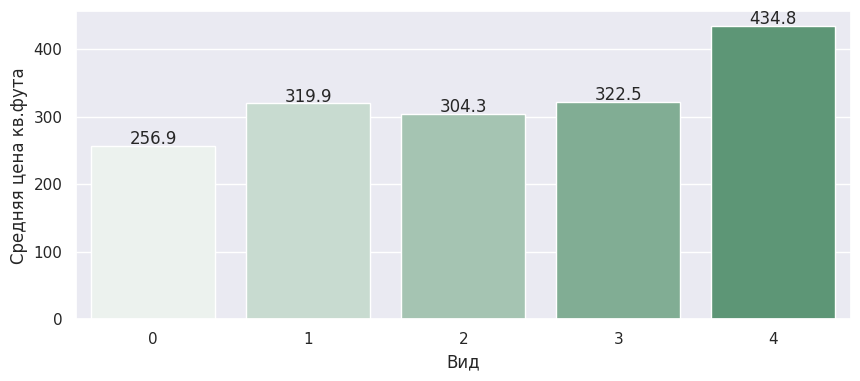

In [25]:
# sns.boxplot(x=df['view'], y=df['ppf'])
df_graph = df.groupby('view')['ppf'].agg(np.mean).reset_index()

plt.figure(figsize=(10, 4))
color_palette = sns.light_palette("seagreen")
splot = sns.barplot(x=df_graph['view'], y=df_graph['ppf'], palette = color_palette)
for g in splot.patches:
    splot.annotate(format(g.get_height(), '.1f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 5),
                   textcoords = 'offset points')
plt.xlabel('Вид')
plt.ylabel('Средняя цена кв.фута');

Отметим крайне похожее поведение зависимостей. Но зависимости не сильные, влияние этих факторов небольшое.

По результатам анализа получается, что <b><u>только наличие вида на водоем и размер дома оказывает определяющее значение на его стоимость</u></b>. Остальные факторы для среднего ценового диапазона практически не влияют на цену кватратного метра.

В заключение посмотрим, как расположены дома на карте.

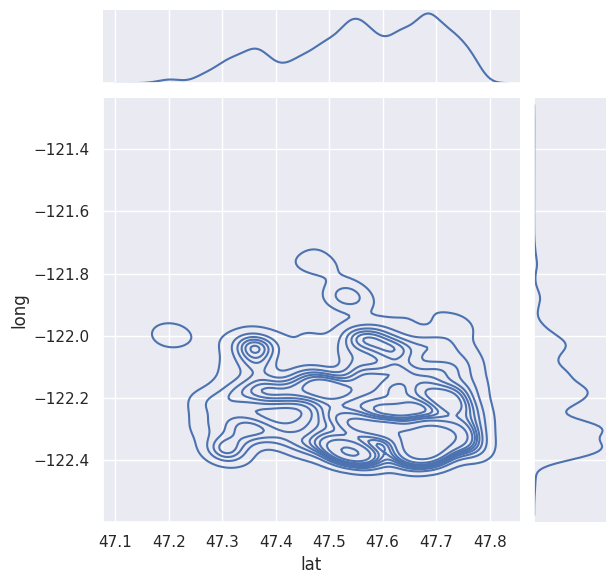

In [26]:
sns.jointplot(x=df['lat'], y=df['long'], kind='kde');

In [27]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup=point.price
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map